<a href="https://colab.research.google.com/github/Aidan4478D/ECE414/blob/main/ECE414_Assignment_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 1: The Santa Fe "Digital Twin" Feasibility Study
## ECE414 - Fundamentals of Remote Sensing and Earth Observation
- Contact: Teams chat
- Submit to: krishna.karra@gmail.com
- *Assigned: Wednesday, February 4 2026*
- *Due: Friday, February 20 2026 (midnight EST)*

## Motivation & Background
Flag_of_New_Mexico.svg

You are a newly hired geospatial data science consultant for the Land of Enchantment, the great state of New Mexico. The governor's office is funding a new digital initiative, focused on developing and proving out geospatial capabilities with satellite imagery. The ultimate goal is to monitor land use changes, enforce water rights, analyze climatic conditions over time and more.

A geospatial consultant was hired in late 2019 to analyze satellite imagery over Santa Fe. After COVID hit and all work went remote, it was slowly discovered that the consultant hadn't made any tangible progress with the data and was delinquent in delivering the necessary reports. This consultant was fired in late 2020, and the work was never picked up again. In 2026, funding has resumed for this initiative, and you have been hired to pick up the task.

The client left behind a stack of raw data and a promise to the government that the data was ready for "immediate analysis". A GIS analyst in the government attempted to run a simple analysis and failed. Your goal as a geospatial data scientist is to make sense of this data and ultimately deliver a report to the governor's office on the utility of this data for the state.

The specifics of what needs to be included in your analysis and report is outlined below. There are two "customers" of your deliverable: (1) the "technical client" e.g. the GIS analyst who has some familiarity with data and interpreting results, and (2) the "business client" e.g. a lawmaker who is only interested in the final products of what you produce.

## Problem Overview
In this problem, you will be analyzing and processing imagery from ESA's Sentinel-2 satellite captured over the greater Santa Fe metro area from 2019 to 2020.

There is a .zip file that contains the contents of this dataset in GeoTIFF format. Each GeoTIFF file contains seven spectral bands, in the following order: (1) red, (2) green, (3) blue, (4) nir, (5) swir1, (6) swir2, and (7) alpha. Note the alpha band represents valid areas in each scene.

## Part 1
The first thing the technical client tried to do was load all the images into a Python datacube to look at the average color of Santa Fe.

*"I tried to stack these images into a numpy array but the code errored out complaining about shape mismatches. I tried visualizing some of the data but it looked all black. Can you help us correct and standardize this data so it's easier to analyze?*

For the technical client, you need to provide a new dataset (all the files can be placed in a .zip file) that they can plug into their existing verification code. For the business client, they need visual and written evidence of the processing steps you took, and what this imagery even looks like, to help them justify keeping you on payroll.

## Part 2
The technical client successfully averaged your corrected stack, but they were unhappy with the results.

*"The average map looks super ghosty, washed out and not at all like what I expected. I animated all the frames and noticed weird black bars flickering in and out of some images. There's clearly some bad data in here, we need a way to only analyze the valid land data.*

You need to devise an approach to figure out which pixels are suitable for analysis in this stack of imagery. The technical client needs to have a way to, for every scene, have a "validity mask" along with the satellite image to figure out which pixels are useful. The business client needs to have this well-documented as part of the report to understand the nuances and limitations of satellite imagery in general.

The technical client had a note with regards to clouds in the imagery:

*"I tried applying a threshold in the nir infrared band to detect clouds which seemed to sort of work, but it had a lot of false positives and missed clouds.*

Neither the technical client or business client are expecting perfection, but they are expecting meaningful progress and a well-documented, automated approach.

## Part 3
As part of the funding of this initiative, the government wants to measure how well satellite imagery can track major environmental and weather-related events using satellite data. To this end, they want you to use satellite imagery to determine, for 2019:

1. When the most snowfall happened
2. When the city had the highest fuel load (wildfire risk)
3. When the city was the driest

The business client expects a date for each one of these, along with a time window that can be inferred from the date. The technical client needs to be able to reproduce your analysis in order to answer follow-up questions using the methods you develop.

Note that the technical client is interested in answering these questions with remote sensing indices that measure standard proxies of vegetation and water. The business client is interested in understanding the limitations that standard remote sensing poses when trying to answer these complex questions.

## Part 4
The government plans to use this digital initiative to foster tourism to Santa Fe and inspire awe about the high desert landscape.

To this end, the business client wants three specific maps to plaster on the walls inside city hall:

1. The Toursim Map - *"We need a picture of Santa Fe that looks like a sunny summer day, with zero clouds and no snow. It needs to look natural but beautiful."*
2. The Fire Risk Map - *"We need a map that assumes the worst case scenario for biomass. It needs to show the absolute greenest point in every place across the year."*
3. The Ski Map - *"Show us the maximum extent of the snowpack for the entire year on one image."*

The business client expects ready-to-print maps for each of these scenarios. Once again, the technical client needs to be able to recreate these maps and possibly make more versions of them in the future.

# Helpful Tips

1. Environment Setup
- **Notebook Ownership:** Create a copy of the original Colaboratory notebook and save it to your personal or university Google Drive.
- **Compute Resources:** As the dataset and processing tasks can be memory-intensive, ensure you are utilizing Colab Pro or a local machine with sufficient processing power to avoid session crashes.

2. Structure & Organization
- **Logical Flow:** Organize the notebook strictly according to the four parts outlined in the assignment.
- **Modular Code:** Use functions for repetitive tasks, such as plotting or index calculation, rather than copy pasting the same code over and over again
- **Intermediate Checkpoints:** It is highly recommended to save the output of Part 1 (the cleaned/masked data) as intermediate files to manage RAM usage more efficiently.

3. Documentation & Analysis
- **Not just "How", but "Why"**: Include Markdown cells explaining your technical choices—for example, why you chose a specific threshold for cloud masking or how you handled coordinate system mismatches.
- **Insightful Commentary:** Discuss any anomalies you find in the Santa Fe dataset, such as the "black bars" or "ghosty" artifacts mentioned by the technical client.

4. Final Delivery
- **Sharing Settings:** Share the notebook with the instructor (krishna.karra@gmail.com) and ensure the permissions are set to "Commenter" so feedback can be provided directly on your work.
- Deadline: Ensure all files and the notebook link are submitted before Friday, February 20, 2026, at midnight EST.

# Data access
The code below should get you started with downloading the dataset to your colab environment and installing the necessary Python packages. You are expected to use other libraries and GIS software as necessary to complete the assignment.

The dataset can also be downloaded locally to your machine from this [link](https://drive.google.com/file/d/17vcid-djDTh0lrTF6VJy_oMcwSc7md1z/view?usp=sharing).

In [28]:
!wget https://storage.googleapis.com/krishna-skytruth-dev/ece471/homework_1/s2_santafe.zip
!unzip -oq s2_santafe.zip

--2026-02-22 21:52:34--  https://storage.googleapis.com/krishna-skytruth-dev/ece471/homework_1/s2_santafe.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 192.178.155.207, 192.178.218.207, 142.250.31.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|192.178.155.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3327331282 (3.1G) [application/zip]
Saving to: ‘s2_santafe.zip’

s2_santafe.zip      100%[===================>]   3.10G   182MB/s    in 19s     

2026-02-22 21:52:53 (166 MB/s) - ‘s2_santafe.zip’ saved [3327331282/3327331282]



In [29]:
!ls s2_santafe/

sentinel-2:L1C_2018-01-07.tif  sentinel-2:L1C_2018-07-18.tif
sentinel-2:L1C_2018-01-12.tif  sentinel-2:L1C_2018-07-21.tif
sentinel-2:L1C_2018-01-14.tif  sentinel-2:L1C_2018-07-23.tif
sentinel-2:L1C_2018-01-27.tif  sentinel-2:L1C_2018-07-26.tif
sentinel-2:L1C_2018-01-29.tif  sentinel-2:L1C_2018-07-28.tif
sentinel-2:L1C_2018-02-08.tif  sentinel-2:L1C_2018-07-31.tif
sentinel-2:L1C_2018-02-11.tif  sentinel-2:L1C_2018-08-02.tif
sentinel-2:L1C_2018-02-13.tif  sentinel-2:L1C_2018-08-05.tif
sentinel-2:L1C_2018-02-18.tif  sentinel-2:L1C_2018-08-07.tif
sentinel-2:L1C_2018-02-21.tif  sentinel-2:L1C_2018-08-10.tif
sentinel-2:L1C_2018-02-23.tif  sentinel-2:L1C_2018-08-12.tif
sentinel-2:L1C_2018-02-28.tif  sentinel-2:L1C_2018-08-17.tif
sentinel-2:L1C_2018-03-03.tif  sentinel-2:L1C_2018-08-20.tif
sentinel-2:L1C_2018-03-10.tif  sentinel-2:L1C_2018-08-25.tif
sentinel-2:L1C_2018-03-13.tif  sentinel-2:L1C_2018-08-27.tif
sentinel-2:L1C_2018-03-15.tif  sentinel-2:L1C_2018-09-04.tif
sentinel-2:L1C_2018-03-2

In [30]:
!ls s2_santafe/ | wc -l

102


In [ ]:
!pip install rasterio

# Part 1

In [31]:
from affine import loadsw
from osgeo import gdal
import rasterio

import numpy as np
import matplotlib.pyplot as plt

import rasterio.features
import rasterio.warp



# contrast stretching
def stretch(band, mask, margin=2, epsilon=1e-6):
    vals = band[mask]

    # used percentiles over min/max as the latter are often dominated by outliers
    low_2 = np.percentile(vals, margin)
    high_2 = np.percentile(vals, 100-margin)

    # clip normalized values between 0 and 1, add epsilon to avoid div by 0 when low_2 = high_2
    return np.clip((band - low_2) / (high_2 - low_2 + epsilon), 0, 1)

def show_fixed_rgb(path, title=None, contrast_stretch=False):
    with rasterio.open(path) as src:
        img = src.read()

        # extract R, G, B & alpha
        R, G, B = img[0].astype(np.float32), img[1].astype(np.float32), img[2].astype(np.float32)
        alpha = img[6] > 0 # valid data mask as bool vector

    if contrast_stretch:
        rgb = np.dstack([
            stretch(R, alpha),
            stretch(G, alpha),
            stretch(B, alpha),
        ])
    else:
        rgb = np.dstack([
            R,
            G,
            B,
        ])

    plt.figure(figsize=(7,7))
    plt.imshow(rgb)
    plt.axis("off")
    plt.title(title if title else path.split("/")[-1])
    plt.show()

# show_fixed_rgb(tif, contrast_stretch=True)
# show_fixed_rgb(tif)


In [58]:
import os
from glob import glob
from collections import Counter

import numpy as np
import rasterio
from rasterio.warp import reproject, Resampling, transform_bounds
from rasterio.transform import Affine

INPUT_DIR  = "/content/s2_santafe"
OUTPUT_DIR = "/content/s2_santafe_fixed_reproj"
os.makedirs(OUTPUT_DIR, exist_ok=True)

files = sorted(glob(os.path.join(INPUT_DIR, "*.tif")))
print("Found:", len(files))

# ---------- helpers ----------
def most_common_crs(paths):
    crs_strs = []
    for p in paths:
        with rasterio.open(p) as src:
            if src.crs is not None:
                crs_strs.append(src.crs.to_string())
    if not crs_strs:
        raise RuntimeError("No CRS found in inputs.")
    counts = Counter(crs_strs)
    crs_str, n = counts.most_common(1)[0]
    return rasterio.crs.CRS.from_string(crs_str), counts

def intersect_bounds_in_crs(paths, dst_crs):
    """Return intersection bounds (left, bottom, right, top) in dst_crs."""
    L, B, R, T = -np.inf, -np.inf, np.inf, np.inf
    for p in paths:
        with rasterio.open(p) as src:
            if src.crs == dst_crs:
                left, bottom, right, top = src.bounds
            else:
                left, bottom, right, top = transform_bounds(
                    src.crs, dst_crs, *src.bounds, densify_pts=21
                )
        L = max(L, left)
        B = max(B, bottom)
        R = min(R, right)
        T = min(T, top)
    if R <= L or T <= B:
        raise RuntimeError("Intersection is empty (no common overlap).")
    return (L, B, R, T)

def grid_from_intersection(bounds, pixel_size):
    """
    Build an aligned affine transform + (width,height) from bounds and pixel size.
    Uses an origin-at-top-left affine and snaps width/height by flooring.
    """
    left, bottom, right, top = bounds
    xres, yres = pixel_size  # yres positive from rasterio src.res but transform uses negative y step

    # enforce North-up affine
    dst_transform = Affine(xres, 0.0, left,
                           0.0, -yres, top)

    width  = int((right - left) / xres)
    height = int((top - bottom) / yres)

    # shrink right/bottom to match integer pixels exactly (keeps inside intersection)
    right_snap  = left + width * xres
    bottom_snap = top - height * yres
    return dst_transform, width, height, (left, bottom_snap, right_snap, top)

# ---------- pick target CRS ----------
target_crs, crs_counts = most_common_crs(files)
print("CRS counts:", dict(crs_counts))
print("Target CRS:", target_crs.to_string())

# ---------- choose a representative pixel size (from a file already in target CRS) ----------
pixel_size = None
for p in files:
    with rasterio.open(p) as src:
        if src.crs == target_crs:
            pixel_size = src.res
            break
if pixel_size is None:
    raise RuntimeError("No file in target CRS found (unexpected).")

# ---------- intersection grid ----------
raw_bounds = intersect_bounds_in_crs(files, target_crs)
dst_transform, dst_width, dst_height, snapped_bounds = grid_from_intersection(raw_bounds, pixel_size)

print(f"Target grid: {dst_height} x {dst_width} pixels")
print("Pixel size:", pixel_size)
print("Snapped bounds:", tuple(round(v, 2) for v in snapped_bounds))

# ---------- process / write ----------
def fix_and_warp(path, dst_transform, dst_crs, dst_h, dst_w):
    with rasterio.open(path) as src:
        cube = src.read().astype(np.float32)  # (7,H,W)
        # radiometry fix in source grid
        cube[:6] = np.clip(cube[:6] / 10000.0, 0, 1)
        cube[6]  = (cube[6] > 0).astype(np.float32)

        out = np.zeros((7, dst_h, dst_w), np.float32)

        for bi in range(7):
            resamp = Resampling.bilinear if bi < 6 else Resampling.nearest
            reproject(
                source=cube[bi],
                destination=out[bi],
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=dst_transform,
                dst_crs=dst_crs,
                resampling=resamp,
            )

        meta = src.meta.copy()
        meta.update(
            driver="GTiff",
            height=dst_h,
            width=dst_w,
            count=7,
            crs=dst_crs,
            transform=dst_transform,
            dtype="float32",
            compress="deflate",
            predictor=3,
        )
    return out, meta

for i, p in enumerate(files, 1):
    out_arr, out_meta = fix_and_warp(p, dst_transform, target_crs, dst_height, dst_width)
    out_name = os.path.basename(p).replace(".tif", "_fixed.tif")
    out_path = os.path.join(OUTPUT_DIR, out_name)
    with rasterio.open(out_path, "w", **out_meta) as dst:
        dst.write(out_arr)
    if i == 1 or i % 25 == 0:
        print(f"Wrote {i}/{len(files)}")

print("Done:", OUTPUT_DIR)

Found: 102
CRS counts: {'EPSG:6528': 34, 'EPSG:3857': 35, 'EPSG:32613': 33}
Target CRS: EPSG:3857
Target grid: 1719 x 1680 pixels
Pixel size: (15.690633957594663, 15.690633957594663)
Snapped bounds: (-11810820.34, 4240966.44, -11784460.08, 4267938.64)
Wrote 1/102
Wrote 25/102
Wrote 50/102
Wrote 75/102
Wrote 100/102
Done: /content/s2_santafe_fixed_reproj


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [79]:
import shutil
import os

TARGET_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/"
os.makedirs(TARGET_DIR, exist_ok=True)

SRC_DIR = "/content/s2_santafe_fixed_reproj"
DST_DIR = TARGET_DIR + "s2_santafe_fixed_reproj"

shutil.copytree(SRC_DIR, DST_DIR, dirs_exist_ok=True)

'/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj'

Found: 10
['/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-07_fixed.tif', '/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-01-12_fixed.tif']


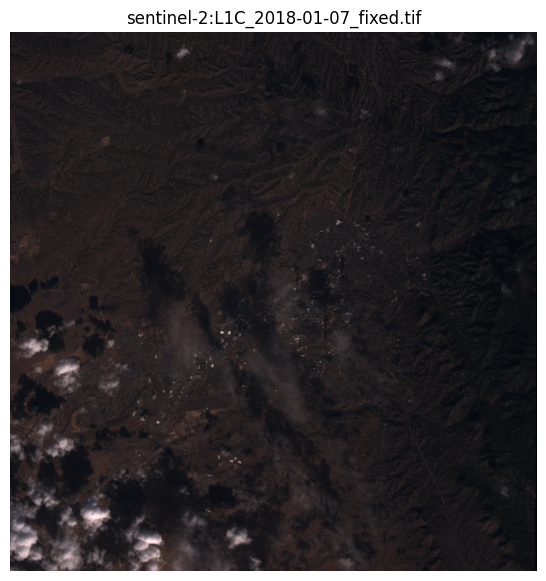

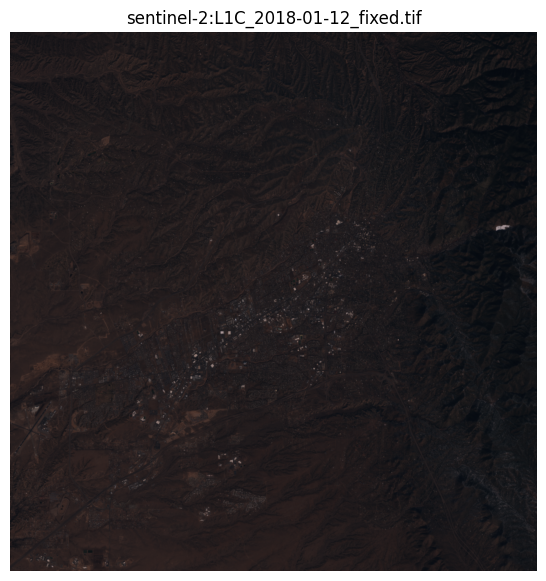

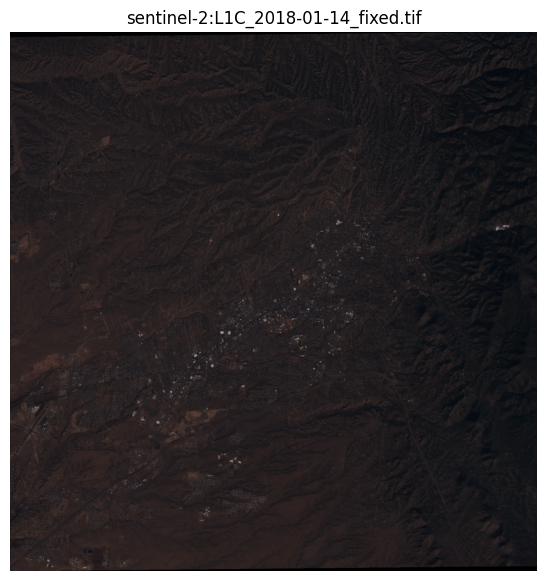

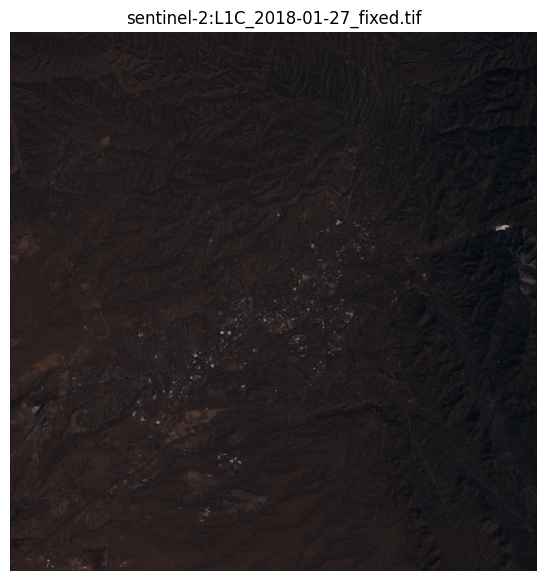

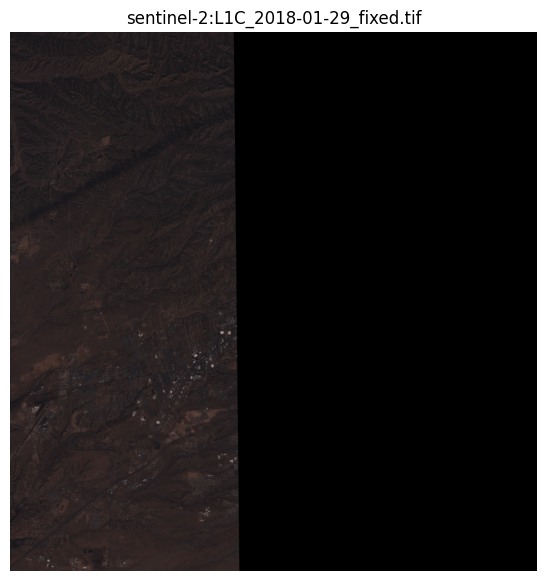

...

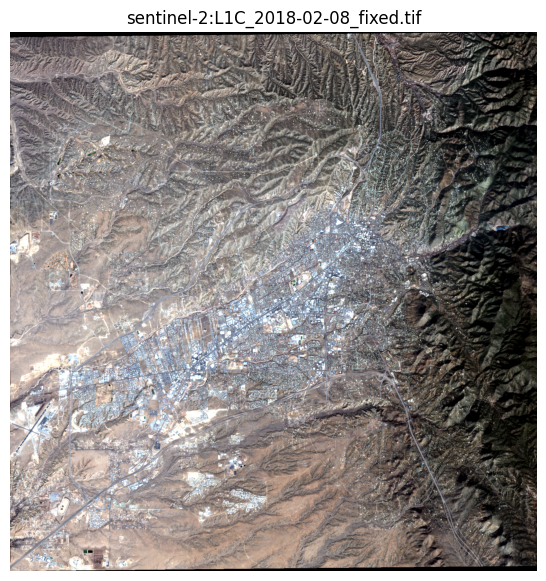

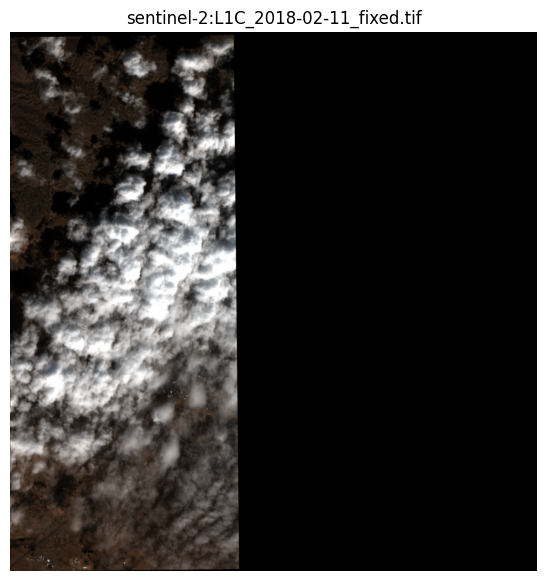

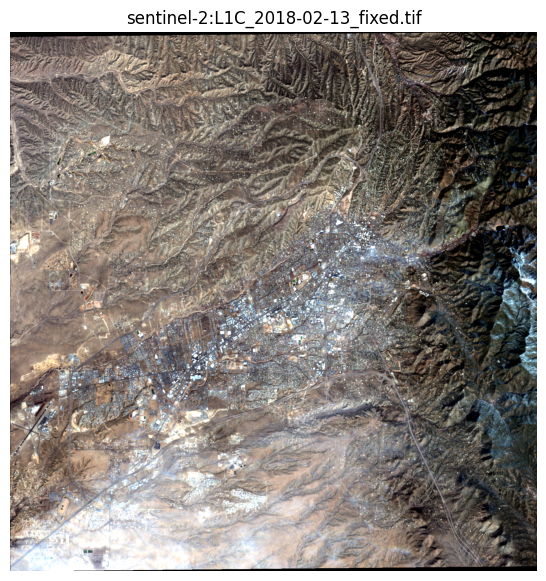

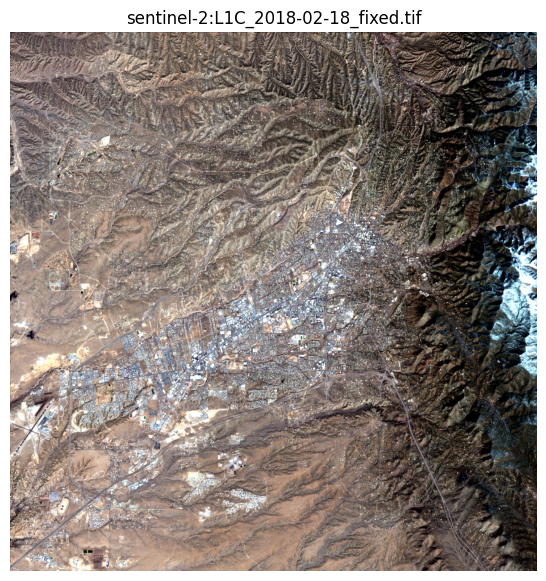

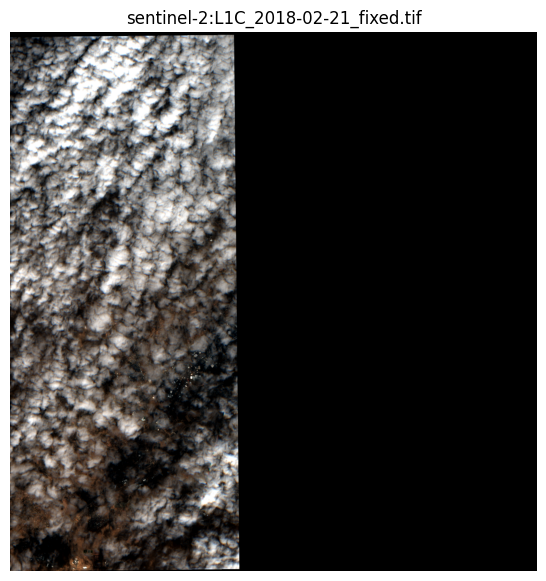

In [80]:
import matplotlib.pyplot as plt
from glob import glob

# /content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed/sentinel-2:L1C_2018-01-07_fixed.tif
# /content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed/sentinel-2:L1C_2018-01-07_fixed.tif
# /content/s2_santafe_fixed_reproj/sentinel-2:L1C_2018-04-19_fixed.tif
show = 10
DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"

test = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))[:show]

print("Found:", len(test))
print(test[:2])

for t in test:
    show_fixed_rgb(t, contrast_stretch=False)

for t in test:
    show_fixed_rgb(t, contrast_stretch=True)

# Part 2

In [82]:
import os
import numpy as np
import rasterio
from glob import glob

DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"
os.makedirs(MASK_DIR, exist_ok=True)

# normalized difference
def nd(a, b, eps=1e-6):
    return (a - b) / (a + b + eps)

def build_valid_mask(img):
    # Get bands & alpha mask
    R, G, B = img[0], img[1], img[2]
    NIR, SWIR1, SWIR2 = img[3], img[4], img[5]
    alpha = img[6] > 0

    # basic features
    brightness = (R + G + B) / 3.0
    ndvi = nd(NIR, R) # vegitation index
    ndsi = nd(G, SWIR1) # snow tends to have high NDSI

    # heuristics (start reasonable, tune later
    snow = (ndsi > 0.4) & (brightness > 0.25) & (NIR > 0.25)
    shadow = (brightness < 0.08) & (NIR < 0.10)

    whiteness = (np.abs(R - G) + np.abs(R - B) + np.abs(G - B))  # small => white/gray

    # "thick cloud" - bright + white-ish + not vegetation + moderate SWIR
    cloud_thick = (
        (brightness > 0.30) &
        (whiteness < 0.10) &
        (ndvi < 0.25) &
        (SWIR1 > 0.12)
    )

    # "thin cloud/haze" - slightly less bright but very white-ish and low contrast
    cloud_thin = (
        (brightness > 0.22) &
        (whiteness < 0.07) &
        (ndvi < 0.35) &
        (SWIR1 > 0.08)
    )

    # avoid misclassifying snow as cloud (snow tends to have high NDSI)
    cloud = (cloud_thick | cloud_thin) & ~(ndsi > 0.35)

    # also remove saturated-ish bright pixels (optional)
    snow_like = (ndsi > 0.35) & (brightness > 0.20)   # loose snow proxy

    very_bright = ((brightness > 0.75) | (R > 0.85) | (G > 0.85) | (B > 0.85)) & (~snow)

    # invalid = cloud | snow | shadow | very_bright | (~alpha)
    # valid = ~(cloud | snow | shadow | very_bright | (~alpha))
    valid = ~(cloud | shadow | very_bright | (~alpha))

    return valid

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))
print("Found scenes:", len(tifs))

for path in tifs:
    with rasterio.open(path) as src:
        img = src.read().astype(np.float32)     # (7,H,W)
        meta = src.meta.copy()

    valid = build_valid_mask(img)               # (H,W) bool

    # write mask as single-band GeoTIFF (Byte)
    mask_meta = meta.copy()
    mask_meta.update(count=1, dtype="uint8", nodata=0)

    out_mask = os.path.join(MASK_DIR, os.path.basename(path).replace("_fixed.tif", "_validmask.tif"))
    with rasterio.open(out_mask, "w", **mask_meta) as dst:
        dst.write(valid.astype(np.uint8), 1)

print("Wrote masks to:", MASK_DIR)


Found scenes: 102
Wrote masks to: /content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks


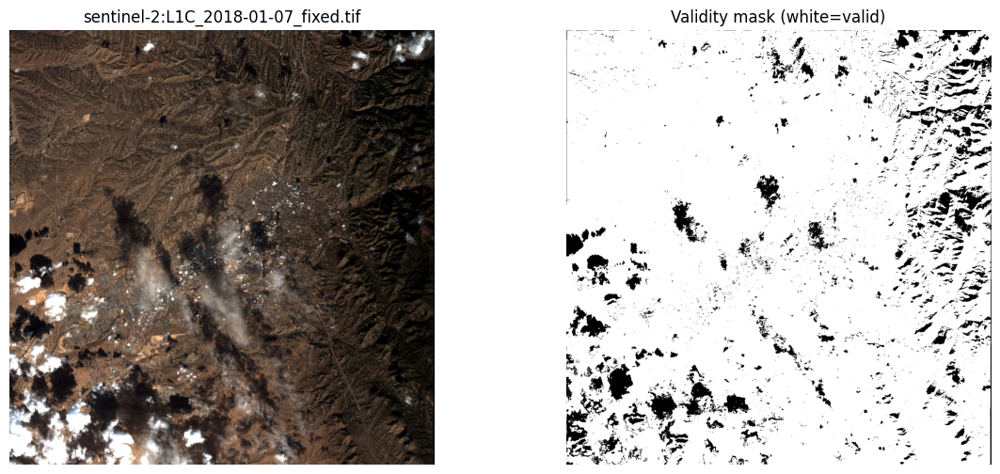

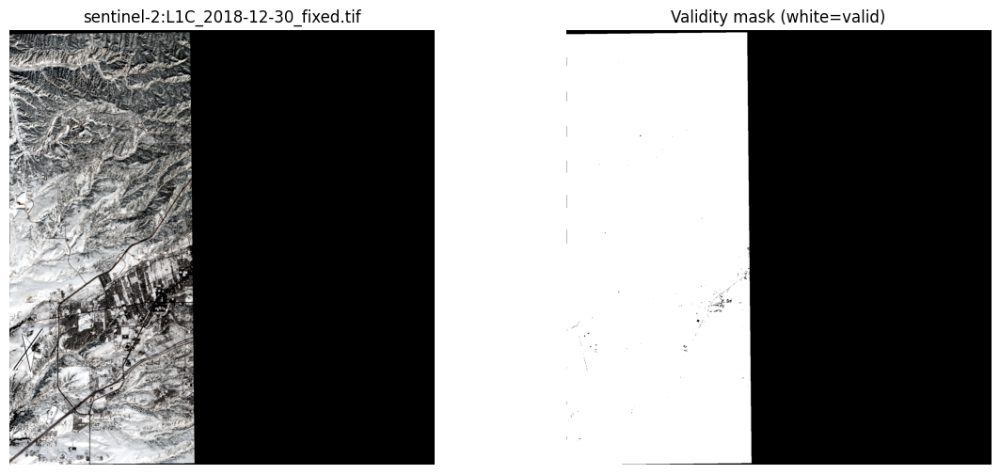

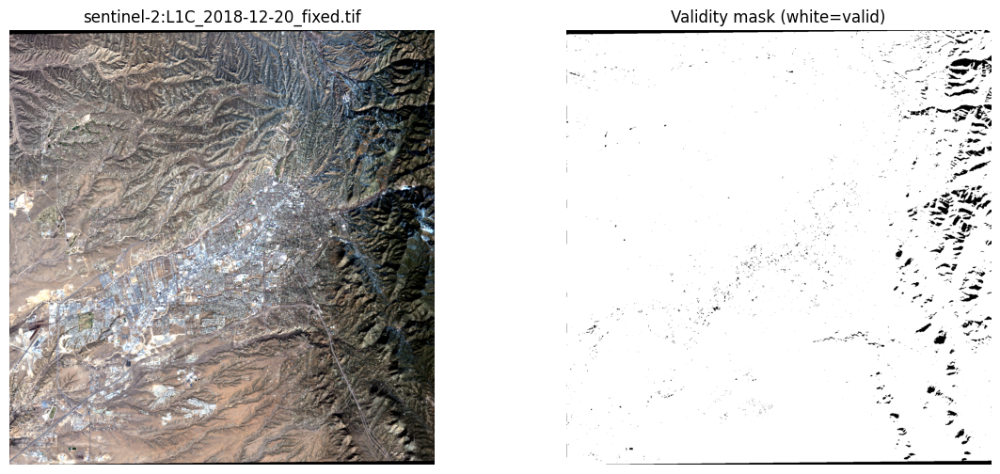

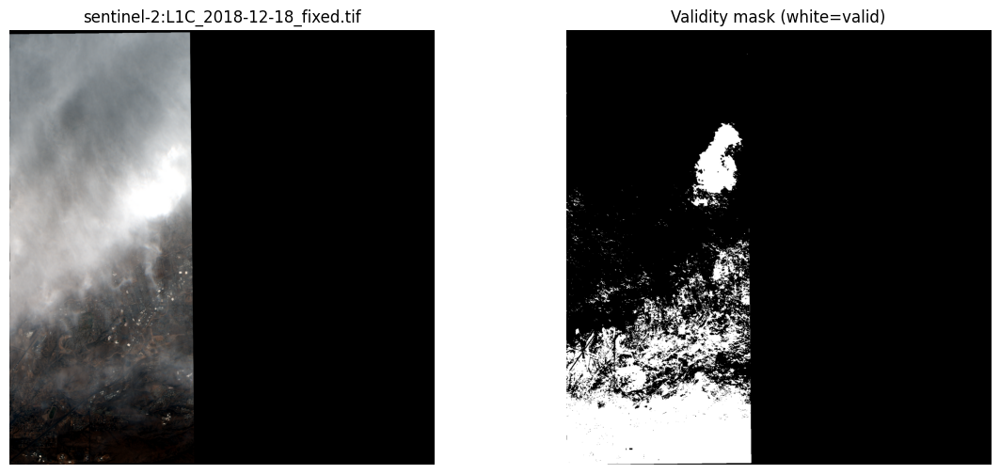

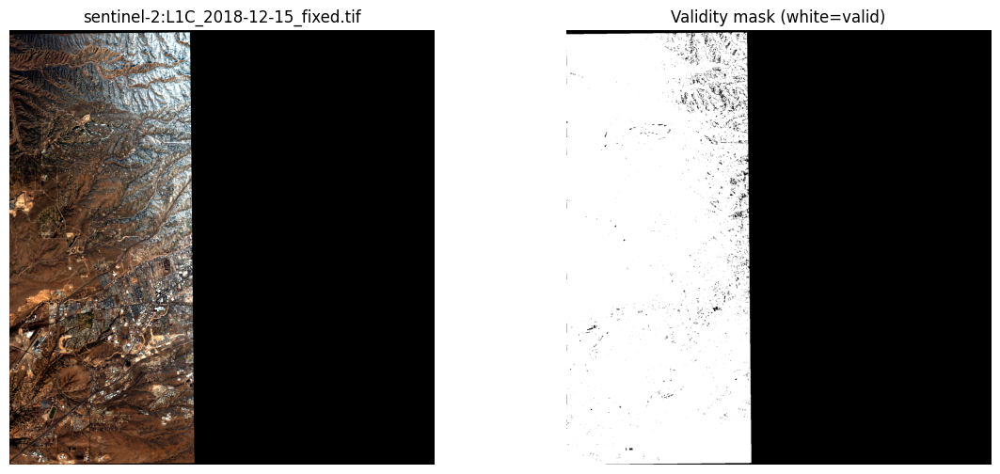

...

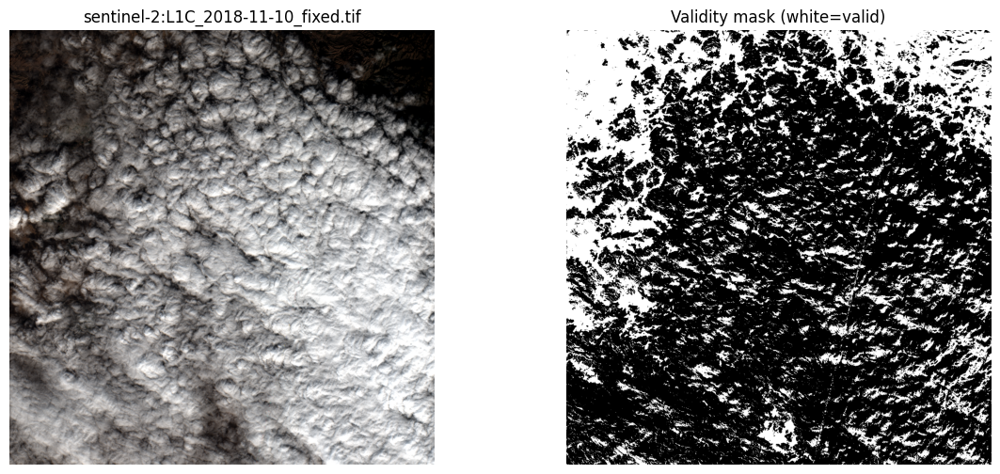

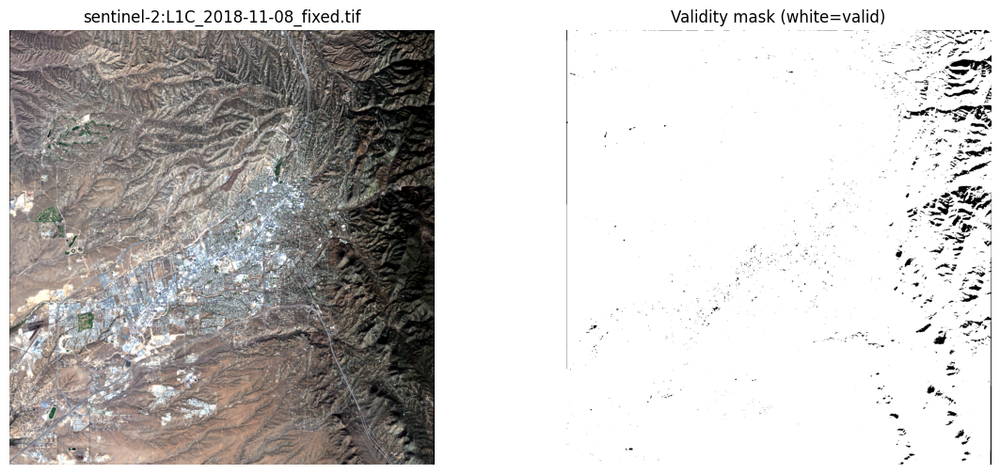

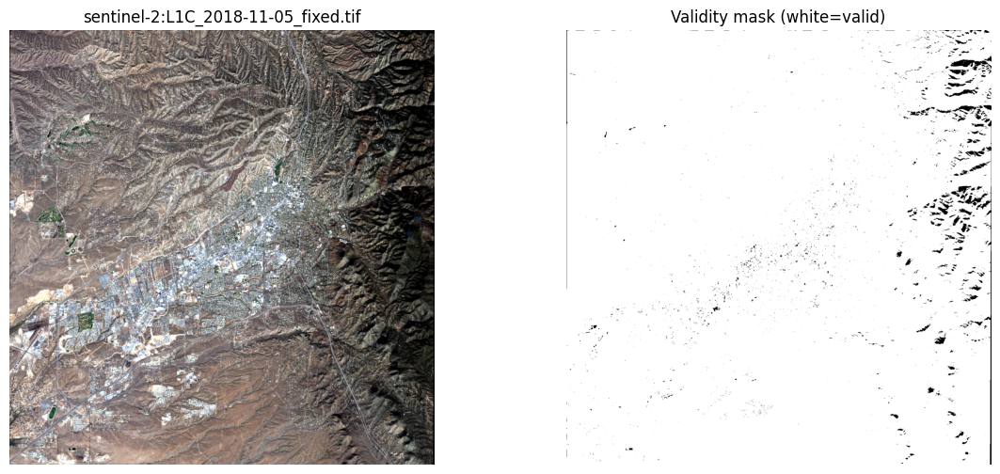

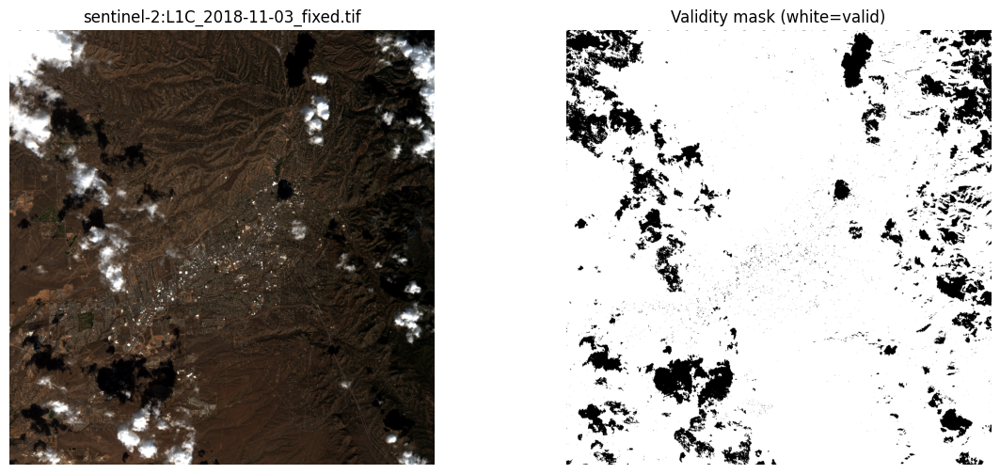

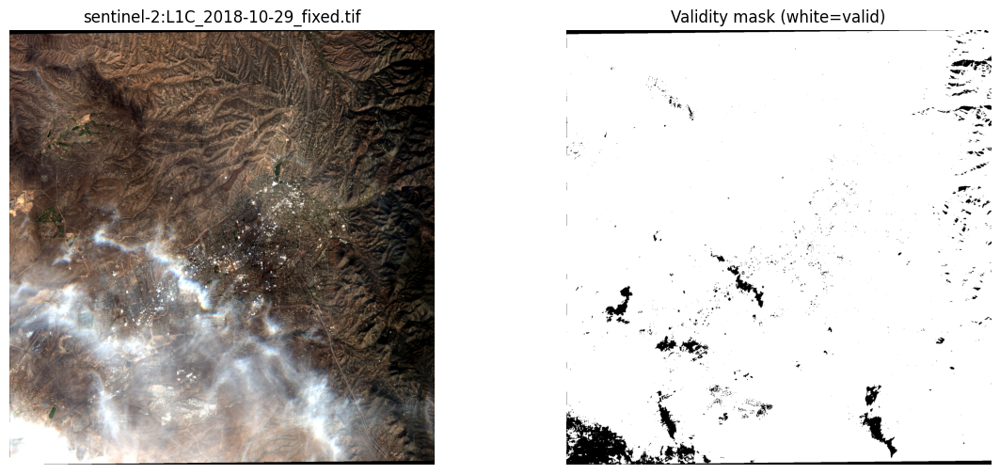

In [83]:
import matplotlib.pyplot as plt

def show_rgb_and_mask(img_path, mask_path, do_stretch=True):
    with rasterio.open(img_path) as src:
        img = src.read().astype(np.float32)
    with rasterio.open(mask_path) as m:
        mask = m.read(1).astype(bool)

    R, G, B = img[0], img[1], img[2]
    alpha = img[6] > 0

    def stretch(band, m, p_low=2, p_high=98, eps=1e-6):
        vals = band[m]
        lo, hi = np.percentile(vals, p_low), np.percentile(vals, p_high)
        return np.clip((band - lo) / (hi - lo + eps), 0, 1)

    if do_stretch:
        rgb = np.dstack([stretch(R, alpha), stretch(G, alpha), stretch(B, alpha)])
    else:
        rgb = np.dstack([R, G, B])

    rgb[~alpha] = 0

    plt.figure(figsize=(14,6))
    plt.subplot(1,2,1)
    plt.imshow(rgb)
    plt.title(img_path.split("/")[-1])
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(mask, cmap="gray")
    plt.title("Validity mask (white=valid)")
    plt.axis("off")
    plt.show()

# example on first scene
# for i in range(len(tifs)):
for i in range(20):
    img0 = tifs[-i]
    mask0 = os.path.join(MASK_DIR, os.path.basename(img0).replace("_fixed.tif", "_validmask.tif"))
    show_rgb_and_mask(img0, mask0, do_stretch=True)


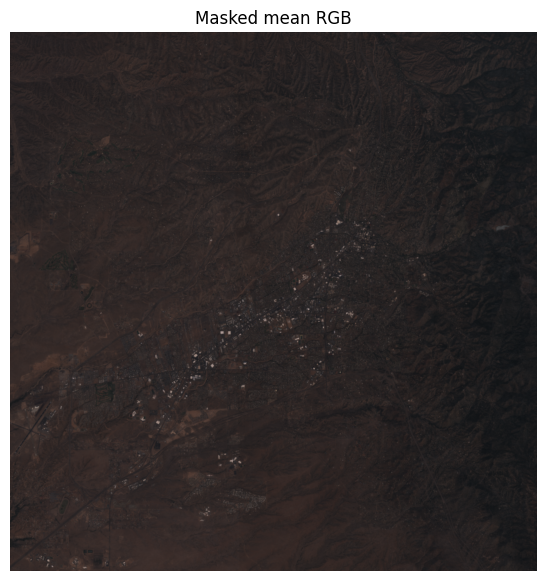

Mean valid coverage: 1.0
Avg #obs per pixel: 88.66439056396484


In [68]:
import numpy as np
import rasterio
from glob import glob
import os
import matplotlib.pyplot as plt

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))
masks = [os.path.join(MASK_DIR, os.path.basename(p).replace("_fixed.tif", "_validmask.tif")) for p in tifs]

# use first image as ref shape
with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

sum_rgb = np.zeros((3, ref_h, ref_w), np.float32)
count   = np.zeros((ref_h, ref_w), np.float32)

for p_img, p_m in zip(tifs, masks):
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        rgb = src.read([1,2,3]).astype(np.float32)  # (3,H,W)

    with rasterio.open(p_m) as msrc:
        valid = (msrc.read(1) > 0)                  # (H,W) bool

    # OPTIONAL safety: ignore places with no footprint if alpha exists in band 7
    # with rasterio.open(p_img) as src:
    #     alpha = src.read(7) > 0
    # valid = valid & alpha

    sum_rgb += np.where(valid[None, :, :], rgb, 0.0)
    count   += valid.astype(np.float32)

mean_rgb = sum_rgb / np.maximum(count[None, :, :], 1e-6)

plt.figure(figsize=(7,7))
plt.imshow(np.clip(mean_rgb.transpose(1,2,0), 0, 1))
plt.axis("off")
plt.title("Masked mean RGB")
plt.show()

print("Mean valid coverage:", float((count > 0).mean()))
print("Avg #obs per pixel:", float(count.mean()))

# Part 3

As part of the funding of this initiative, the government wants to measure how well satellite imagery can track major environmental and weather-related events using satellite data. To this end, they want you to use satellite imagery to determine, for 2019:

- When the most snowfall happened
- When the city had the highest fuel load (wildfire risk)
- When the city was the driest

The business client expects a date for each one of these, along with a time window that can be inferred from the date. The technical client needs to be able to reproduce your analysis in order to answer follow-up questions using the methods you develop.

Note that the technical client is interested in answering these questions with remote sensing indices that measure standard proxies of vegetation and water. The business client is interested in understanding the limitations that standard remote sensing poses when trying to answer these complex questions.

Scenes used: 102


,date,img_path,mask_path,snow_frac,ndsi_med,ndvi_med,ndmi_med,nbr2_med,valid_frac,footprint_frac,clear_frac_total
0,2018-01-07,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,7.678920e-07,-0.295538,0.167188,-0.052911,0.121844,0.903380,0.998330,0.901872
1,2018-01-12,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.561703e-04,-0.322484,0.174168,-0.068033,0.115814,0.971372,0.999780,0.971159
2,2018-01-14,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.005969e-04,-0.323810,0.181821,-0.058097,0.109947,0.975752,0.991282,0.967245
3,2018-01-27,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,1.898256e-04,-0.325541,0.176680,-0.061772,0.104861,0.979568,1.000000,0.979568
4,2018-01-29,/content/drive/MyDrive/datasets/ece414_remote_...,/content/drive/MyDrive/datasets/ece414_remote_...,0.000000e+00,-0.340087,0.137597,-0.103017,0.090489,0.997525,0.430013,0.428949


Scenes used (no coverage filter): 102
Scenes passing footprint+clear filter: 85 / 102
        date  footprint_frac  clear_frac_total  valid_frac
0 2018-01-07        0.998330          0.901872    0.903380
1 2018-01-12        0.999780          0.971159    0.971372
2 2018-01-14        0.991282          0.967245    0.975752
3 2018-01-27        1.000000          0.979568    0.979568
5 2018-02-08        0.990659          0.978281    0.987505
Most snow: 2018-12-13 snow_frac: 0.6134951826633984 coverage: 0.9178078966222086
Highest fuel load: 2018-08-27 ndvi_med: 0.22718733549118042 coverage: 0.9076081582394606
Driest: 2018-06-21 ndmi_med: -0.11765006184577942 coverage: 0.9866619045870466


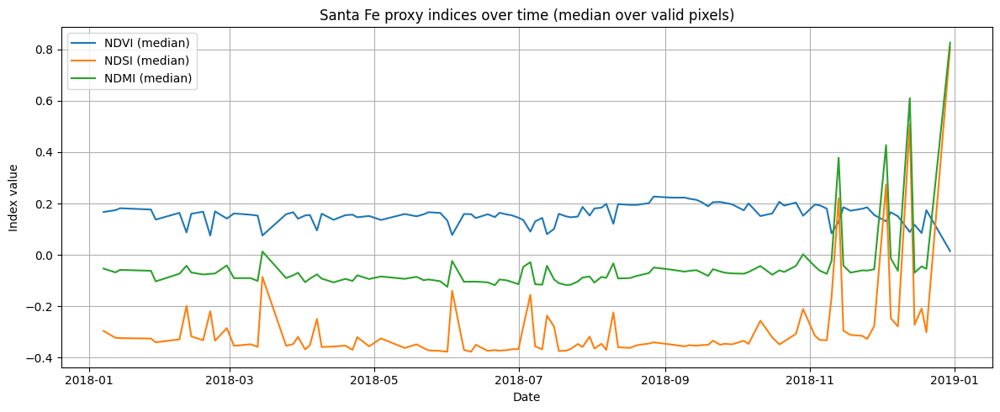

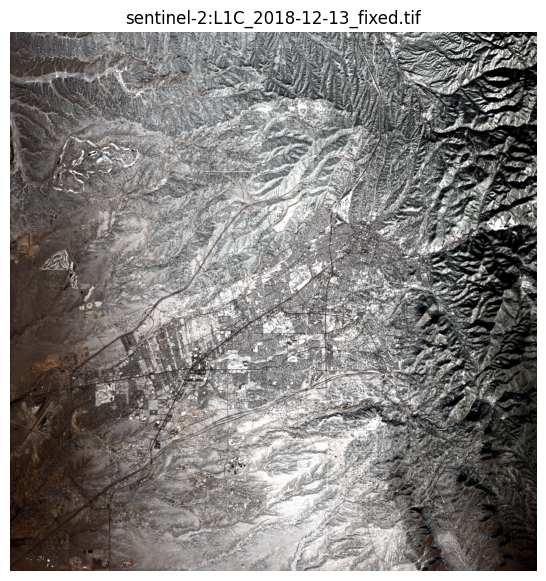

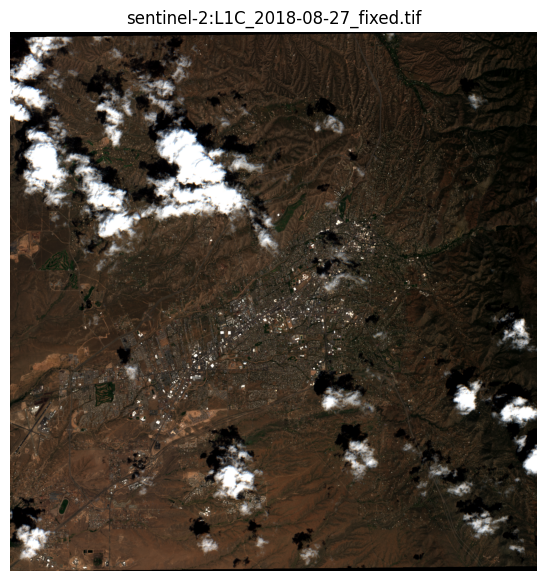

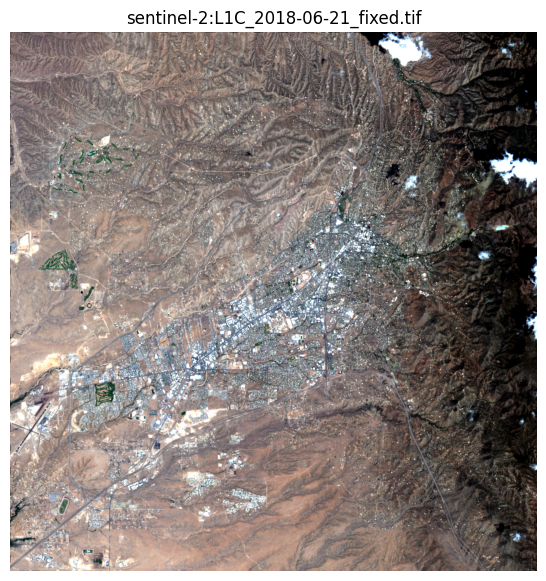

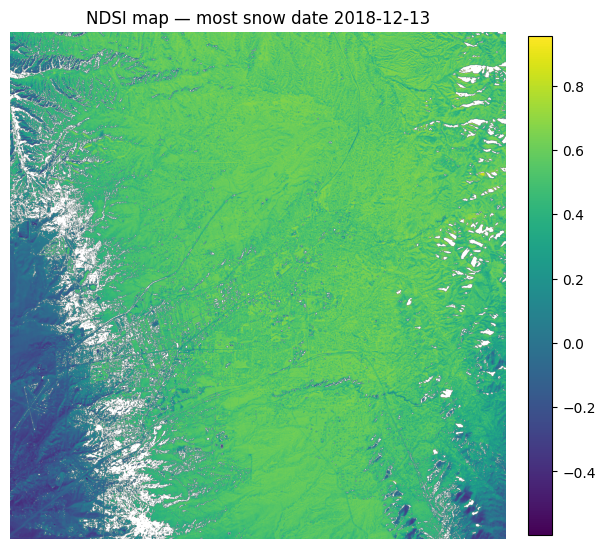

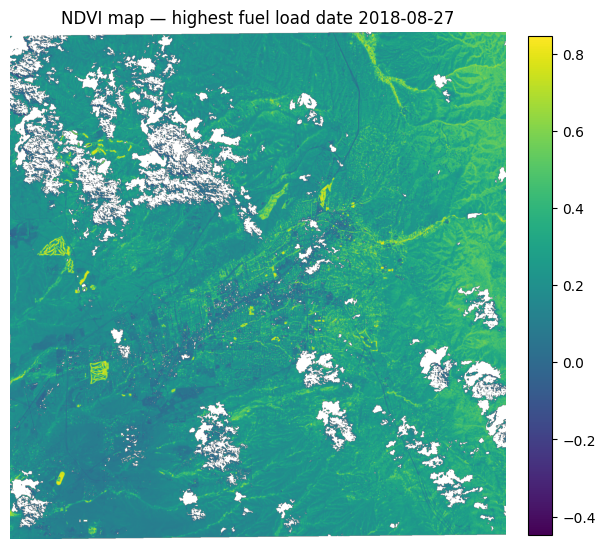

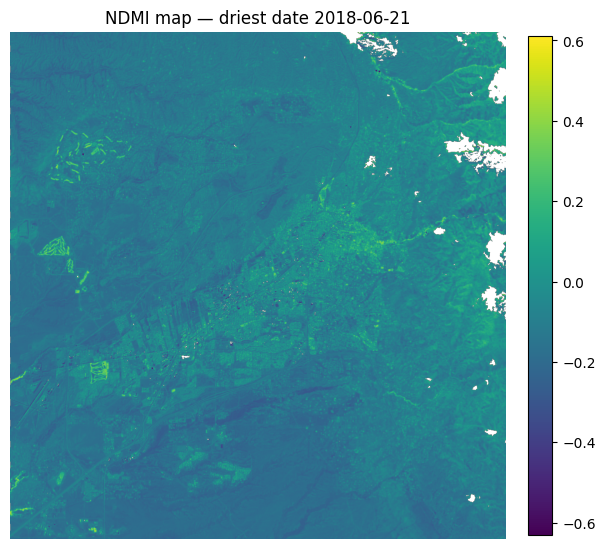

In [85]:
import os, re
from glob import glob
import numpy as np
import pandas as pd
import rasterio
import matplotlib.pyplot as plt

DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed_reproj"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"

def parse_date_from_name(path):
    m = re.search(r"(\d{4}-\d{2}-\d{2})", os.path.basename(path))
    if not m:
        raise ValueError(f"Could not parse date from filename: {path}")
    return pd.to_datetime(m.group(1))

def nd(a, b, eps=1e-6):
    return (a - b) / (a + b + eps)

# ---- Build per-scene summary table ----
rows = []
tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))

# print("Num tifs:", len(tifs))
# print("Num rows:", len(rows))
# print("Example tif:", tifs[0] if tifs else None)

for p_img in tifs:
    date = parse_date_from_name(p_img)

    # using pre-2019 data
    if date.year >= 2019:
        continue

    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        SWIR2 = src.read(6).astype(np.float32)
        alpha = src.read(7) > 0

    with rasterio.open(p_m) as m:
        valid = (m.read(1) > 0) & alpha

    if valid.sum() < 1000:
        continue

    brightness = (R + G + B) / 3.0

    ndvi = nd(NIR, R)
    ndmi = nd(NIR, SWIR1)
    ndsi = nd(G, SWIR1)
    nbr2 = nd(SWIR1, SWIR2)

    snow = valid & (ndsi > 0.40) & (brightness > 0.25)
    snow_frac = snow.sum() / valid.sum()

    H, W = alpha.shape
    total_pixels = int(alpha.size)

    alpha_pixels = int(alpha.sum())           # footprint pixels
    valid_pixels = int(valid.sum())           # clear pixels within footprint

    footprint_frac = alpha_pixels / max(total_pixels, 1)     # footprint coverage of full frame
    valid_frac = valid_pixels / max(alpha_pixels, 1)     # clarity inside footprint (what you already had)
    clear_frac_total  = valid_pixels / max(total_pixels, 1)     # clear coverage of full frame

    rows.append({
        "date": date,
        "img_path": p_img,
        "mask_path": p_m,
        "snow_frac": float(snow_frac),
        "ndsi_med": float(np.median(ndsi[valid])),
        "ndvi_med": float(np.median(ndvi[valid])),
        "ndmi_med": float(np.median(ndmi[valid])),
        "nbr2_med": float(np.median(nbr2[valid])),
        "valid_frac": float(valid_frac),
        "footprint_frac": float(footprint_frac),
        "clear_frac_total": float(clear_frac_total),
    })

df = pd.DataFrame(rows).sort_values("date").reset_index(drop=True)

# ensure numeric
for col in ["snow_frac", "ndvi_med", "ndmi_med", "ndsi_med", "nbr2_med", "valid_frac"]:
    df[col] = pd.to_numeric(df[col], errors="coerce")

df = df.dropna(subset=["date", "ndmi_med"]).sort_values("date").reset_index(drop=True)

print("Scenes used:", len(df))
display(df.head())

# -------------------- DROP-IN: min coverage filter --------------------
# Add ONE field to your rows: valid_frac = valid pixels / footprint pixels (alpha)
# Then create df_good and use it for picking event dates (snow/fuel/dry).

MIN_FOOTPRINT = 0.90      # footprint must cover >= 90% of the frame
MIN_CLEAR_TOTAL = 0.75    # clear pixels must cover >= 75% of the frame

print(f"Scenes used (no coverage filter): {len(df)}")

df_good = df[
    (df["footprint_frac"] >= MIN_FOOTPRINT) &
    (df["clear_frac_total"] >= MIN_CLEAR_TOTAL)
].copy()

print(f"Scenes passing footprint+clear filter: {len(df_good)} / {len(df)}")
print(df_good[["date","footprint_frac","clear_frac_total","valid_frac"]].sort_values("date").head())

# ---- Pick event dates from df_good instead of df ----
snow_row = df_good.loc[df_good["snow_frac"].idxmax()]
fuel_row = df_good.loc[df_good["ndvi_med"].idxmax()]
dry_row  = df_good.loc[df_good["ndmi_med"].idxmin()]

print("Most snow:", snow_row["date"].date(), "snow_frac:", snow_row["snow_frac"], "coverage:", snow_row["valid_frac"])
print("Highest fuel load:", fuel_row["date"].date(), "ndvi_med:", fuel_row["ndvi_med"], "coverage:", fuel_row["valid_frac"])
print("Driest:", dry_row["date"].date(), "ndmi_med:", dry_row["ndmi_med"], "coverage:", dry_row["valid_frac"])
# ---------------------------------------------------------------------

# ---- 1) Time series plot (line graph) ----
plt.figure(figsize=(12,5))
plt.plot(df["date"], df["ndvi_med"], label="NDVI (median)")
plt.plot(df["date"], df["ndsi_med"], label="NDSI (median)")
plt.plot(df["date"], df["ndmi_med"], label="NDMI (median)")
plt.title("Santa Fe proxy indices over time (median over valid pixels)")
plt.xlabel("Date")
plt.ylabel("Index value")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# ---- Helper to show an index map ----
def show_index_map(img_path, mask_path, which="ndvi", title=""):
    with rasterio.open(img_path) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = src.read(7) > 0

    with rasterio.open(mask_path) as m:
        valid = (m.read(1) > 0) & alpha

    if which == "ndvi":
        idx = nd(NIR, R)
    elif which == "ndsi":
        idx = nd(G, SWIR1)
    elif which == "ndmi":
        idx = nd(NIR, SWIR1)
    else:
        raise ValueError("which must be one of: ndvi, ndsi, ndmi")

    idx_show = np.where(valid, idx, np.nan)

    plt.figure(figsize=(7,7))
    plt.imshow(idx_show)  # default matplotlib colormap
    plt.axis("off")
    plt.title(title)
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.show()

# ---- 2) Show the three key RGB scenes ----
show_fixed_rgb(snow_row["img_path"], f"Most snow RGB — {snow_row['date'].date()}", do_stretch=True)
show_fixed_rgb(fuel_row["img_path"], f"Highest fuel load RGB — {fuel_row['date'].date()}", do_stretch=True)
show_fixed_rgb(dry_row["img_path"],  f"Driest RGB — {dry_row['date'].date()}", do_stretch=True)

# ---- 3) Show corresponding index maps ----
show_index_map(snow_row["img_path"], snow_row["mask_path"], which="ndsi",
               title=f"NDSI map — most snow date {snow_row['date'].date()}")

show_index_map(fuel_row["img_path"], fuel_row["mask_path"], which="ndvi",
               title=f"NDVI map — highest fuel load date {fuel_row['date'].date()}")

show_index_map(dry_row["img_path"], dry_row["mask_path"], which="ndmi",
               title=f"NDMI map — driest date {dry_row['date'].date()}")

# Part 4

The government plans to use this digital initiative to foster tourism to Santa Fe and inspire awe about the high desert landscape.

To this end, the business client wants three specific maps to plaster on the walls inside city hall:

- The Toursim Map - "We need a picture of Santa Fe that looks like a sunny summer day, with zero clouds and no snow. It needs to look natural but beautiful."
- The Fire Risk Map - "We need a map that assumes the worst case scenario for biomass. It needs to show the absolute greenest point in every place across the year."
- The Ski Map - "Show us the maximum extent of the snowpack for the entire year on one image."

The business client expects ready-to-print maps for each of these scenarios. Once again, the technical client needs to be able to recreate these maps and possibly make more versions of them in the future.

In [ ]:
import os, re
from glob import glob
import numpy as np
import rasterio
import matplotlib.pyplot as plt
from rasterio.warp import reproject, Resampling

DATA_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_fixed"
MASK_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/s2_santafe_masks"
OUT_DIR = "/content/drive/MyDrive/datasets/ece414_remote_sensing/cityhall_maps"
os.makedirs(OUT_DIR, exist_ok=True)

tifs = sorted(glob(os.path.join(DATA_DIR, "*_fixed.tif")))

# reference grid from first scene (same as your mean code)
with rasterio.open(tifs[0]) as ref:
    ref_crs = ref.crs
    ref_transform = ref.transform
    ref_h, ref_w = ref.height, ref.width

print("Scenes:", len(tifs), "Ref shape:", (ref_h, ref_w))

Scenes: 102 Ref shape: (1504, 1469)


### Tourist Map

Summer scenes: 42


/tmp/ipython-input-3623599706.py:69: RuntimeWarning: All-NaN slice encountered
  tourism_R = np.nanmedian(all_r, axis=0)
/tmp/ipython-input-3623599706.py:70: RuntimeWarning: All-NaN slice encountered
  tourism_G = np.nanmedian(all_g, axis=0)
/tmp/ipython-input-3623599706.py:71: RuntimeWarning: All-NaN slice encountered
  tourism_B = np.nanmedian(all_b, axis=0)


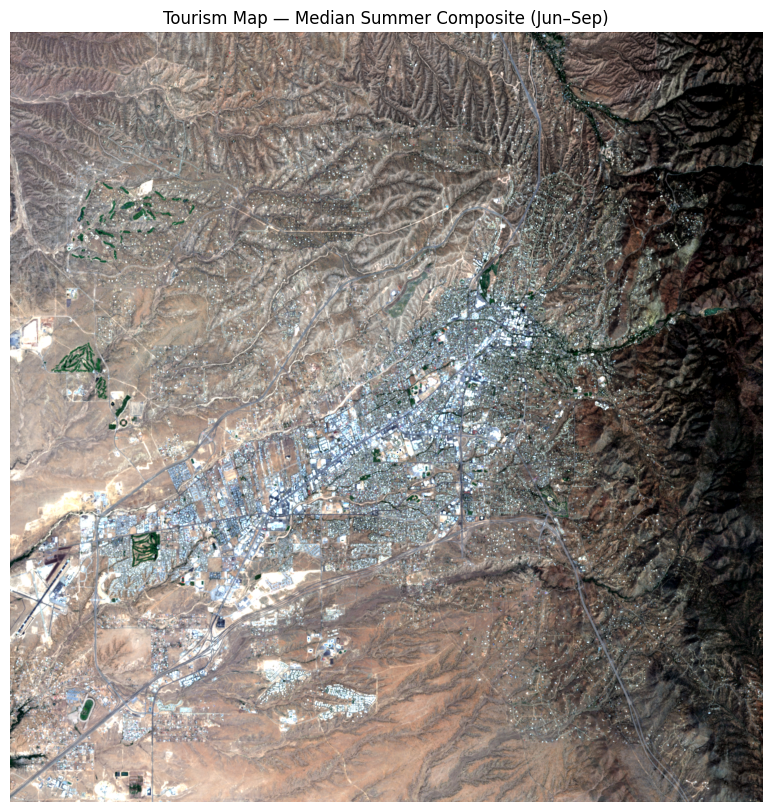

Tourism composite coverage: 100.0%


In [89]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

# Assumes:
# - tifs is your list of *_fixed.tif paths in DATA_DIR
# - MASK_DIR contains matching *_validmask.tif for each
# - parse_date_from_name, nd, and stretch(band, mask) are defined

# --- collect summer scenes ---
summer = []
for p_img in tifs:
    d = parse_date_from_name(p_img)
    if d.month < 6 or d.month > 9:
        continue
    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if os.path.exists(p_m):
        summer.append((d, p_img, p_m))

print("Summer scenes:", len(summer))
if len(summer) == 0:
    raise RuntimeError("No summer scenes found with masks. Check tifs/MASK_DIR.")

# reference shape from first summer image
with rasterio.open(summer[0][1]) as ref:
    ref_h, ref_w = ref.height, ref.width

# stack arrays: (T, H, W)
all_r = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_g = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_b = np.full((len(summer), ref_h, ref_w), np.nan, np.float32)
all_usable = np.zeros((len(summer), ref_h, ref_w), bool)

MIN_FOOTPRINT = 0.85  # reject scenes whose footprint covers too little of the frame

for i, (d, p_img, p_m) in enumerate(summer):
    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    footprint_frac = float(alpha.mean())
    if footprint_frac < MIN_FOOTPRINT:
        continue

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    valid = validmask & alpha

    # tourism exclusions: clouds + snow
    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0
    snow = (ndsi > 0.35) & (brightness > 0.20)

    # simple cloud proxy (keep/tune as desired)
    cloud = (brightness > 0.35) & (~snow)

    usable = valid & (~snow) & (~cloud)

    all_r[i] = np.where(usable, R, np.nan)
    all_g[i] = np.where(usable, G, np.nan)
    all_b[i] = np.where(usable, B, np.nan)
    all_usable[i] = usable

tourism_R = np.nanmedian(all_r, axis=0)
tourism_G = np.nanmedian(all_g, axis=0)
tourism_B = np.nanmedian(all_b, axis=0)

has_data = np.any(all_usable, axis=0)

rgb_tourism = np.dstack([
    stretch(tourism_R, has_data),
    stretch(tourism_G, has_data),
    stretch(tourism_B, has_data),
])

# make NO-DATA white (prints nicer)
rgb_tourism[~has_data] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(rgb_tourism)
plt.axis("off")
plt.title("Tourism Map — Median Summer Composite (Jun–Sep)")
plt.show()

print(f"Tourism composite coverage: {100*has_data.mean():.1f}%")

### Fire Risk Map

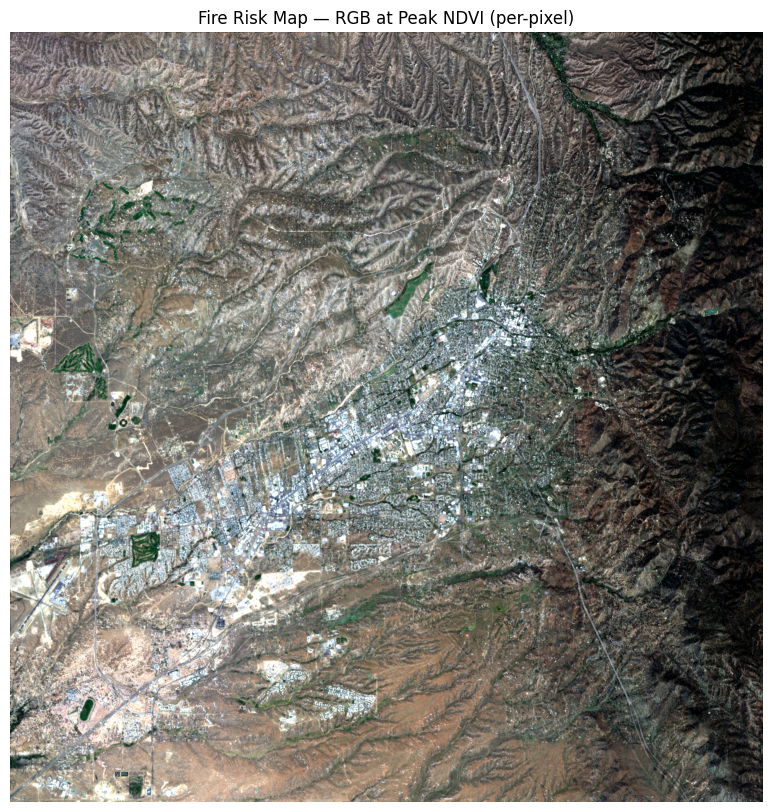

In [90]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

# initialize from any one image (all same shape now)
with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

max_ndvi = np.full((ref_h, ref_w), -999.0, np.float32)
fire_rgb = np.zeros((ref_h, ref_w, 3), np.float32)
has_fire = np.zeros((ref_h, ref_w), bool)

veg_months = {5, 6, 7, 8, 9}

for p_img in tifs:
    d = parse_date_from_name(p_img)
    if d.month not in veg_months:
        continue

    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        NIR = src.read(4).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    valid = validmask & alpha

    # exclude snow + simple cloud proxy
    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0
    snow = (ndsi > 0.30) & (brightness > 0.20)
    cloud = (brightness > 0.35) & (~snow)

    ndvi = nd(NIR, R)
    looks_like_veg = NIR > (B * 1.5)

    usable = valid & (~snow) & (~cloud) & looks_like_veg
    better = usable & (ndvi > max_ndvi)

    max_ndvi[better] = ndvi[better]
    fire_rgb[better, 0] = R[better]
    fire_rgb[better, 1] = G[better]
    fire_rgb[better, 2] = B[better]
    has_fire |= better

# fill gaps with tourism composite to avoid holes
gaps = (~has_fire) & (np.isfinite(tourism_R))
fire_rgb[gaps, 0] = tourism_R[gaps]
fire_rgb[gaps, 1] = tourism_G[gaps]
fire_rgb[gaps, 2] = tourism_B[gaps]
has_fire |= gaps

# stretch for display
fire_vis = np.dstack([
    stretch(fire_rgb[:, :, 0], has_fire),
    stretch(fire_rgb[:, :, 1], has_fire),
    stretch(fire_rgb[:, :, 2], has_fire),
])
fire_vis[~has_fire] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(fire_vis)
plt.axis("off")
plt.title("Fire Risk Map — RGB at Peak NDVI (per-pixel)")
plt.show()

### Ski Map

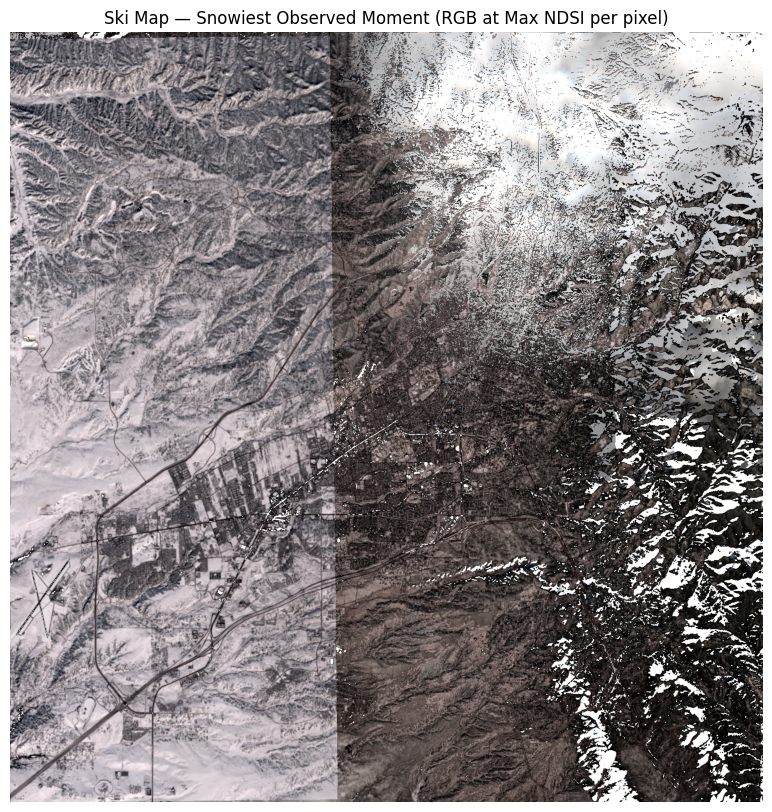

In [97]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt

# Assumes: tifs, MASK_DIR, nd(), stretch() already exist
# Also assumes all fixed files + masks share same shape/grid.

with rasterio.open(tifs[0]) as ref:
    ref_h, ref_w = ref.height, ref.width

snow_any = np.zeros((ref_h, ref_w), dtype=bool)
snow_count = np.zeros((ref_h, ref_w), dtype=np.uint16)

max_ndsi = np.full((ref_h, ref_w), -999.0, dtype=np.float32)
snow_rgb = np.zeros((ref_h, ref_w, 3), dtype=np.float32)

for p_img in tifs:
    p_m = os.path.join(MASK_DIR, os.path.basename(p_img).replace("_fixed.tif", "_validmask.tif"))
    if not os.path.exists(p_m):
        continue

    with rasterio.open(p_img) as src:
        R = src.read(1).astype(np.float32)
        G = src.read(2).astype(np.float32)
        B = src.read(3).astype(np.float32)
        SWIR1 = src.read(5).astype(np.float32)
        alpha = (src.read(7) > 0)

    with rasterio.open(p_m) as msrc:
        validmask = (msrc.read(1) > 0)

    valid = validmask & alpha

    ndsi = nd(G, SWIR1)
    brightness = (R + G + B) / 3.0

    snow = valid & (ndsi > 0.35) & (brightness > 0.20)

    snow_any |= snow
    snow_count += snow.astype(np.uint16)

    better = snow & (ndsi > max_ndsi)
    max_ndsi[better] = ndsi[better]
    snow_rgb[better, 0] = R[better]
    snow_rgb[better, 1] = G[better]
    snow_rgb[better, 2] = B[better]

# --- RGB snowiest map (stretched) ---
has_rgb = max_ndsi > -999

snow_rgb_vis = np.dstack([
    stretch(snow_rgb[:, :, 0], has_rgb),
    stretch(snow_rgb[:, :, 1], has_rgb),
    stretch(snow_rgb[:, :, 2], has_rgb),
])
snow_rgb_vis[~has_rgb] = 1.0

plt.figure(figsize=(10,10))
plt.imshow(snow_rgb_vis)
plt.axis("off")
plt.title("Ski Map — Snowiest Observed Moment (RGB at Max NDSI per pixel)")
plt.show()